#### Covid analysis 

In [39]:
import scanpy as sc
import numpy as np 
sc.settings.set_figure_params(dpi=150, frameon=False, facecolor='white')
import pandas as pd

In [2]:
adata = sc.read("../data/covid/covid_integrated_new_for_pub2.h5ad")

In [3]:
sc.pp.normalize_total(adata,key_added="scale_factors",exclude_highly_expressed=True,target_sum=1e4)

In [4]:
sc.pp.log1p(adata)

In [5]:
adata.obs["condition"].replace("nan","control",inplace=True)

In [90]:
covid = adata[adata.obs["study"] == 'COVID-19 (query)']
other = adata[adata.obs["study"] != 'COVID-19 (query)']

In [7]:
other.obs["condition2"] = other.obs["condition"] 

Trying to set attribute `.obs` of view, copying.


In [8]:
covid.obs["condition2"] = covid.obs["condition"]
covid.obs["condition2"].replace("control","control (query)",inplace=True)

Trying to set attribute `.obs` of view, copying.


In [88]:
covid

AnnData object with n_obs × n_vars = 62469 × 18474
    obs: 'age', 'age_range', 'anatomical_region', 'anatomical_region_detailed', 'batch', 'dataset', 'disease', 'donor', 'ethnicity', 'ethnicity_mixed', 'last_author/PI', 'lung_vs_nasal', 'original_celltype_ann', 'pack_years', 'sample', 'sample_alias', 'sample_type', 'sampling_method', 'sex', 'smoking', 'total_counts', 'log10_total_counts', 'n_genes_detected', 'mito_frac', 'ribo_frac', 'compl', 'ann_level_1', 'ann_level_2', 'ann_level_3', 'ann_level_4', 'ann_level_5', 'ann_highest_res', 'ann_new', 'subject_type', 'study', 'study2', 'celltype', 'condition', 'cellnames', 'cluster', 'stage', 'ID', 'sample_new', 'chemistry', 'data_type', 'dpt_pseudotime', 'final_annotation', 'mt_frac', 'n_counts', 'n_genes', 'sample_ID', 'size_factors', 'species', 'tissue', 'scale_factors', 'condition2'
    var: 'n_cells-0', 'n_cells-0-0-1-0-0', 'feature_types-1-0-1-0-0', 'genome-1-0-1-0-0', 'n_cells-0-0-1-1-0', 'feature_types-1-0-1-1-0', 'genome-1-0-1-1-0'

In [9]:
covid.obs_names_make_unique()
other.obs_names_make_unique()

In [10]:
adata = covid.concatenate(other)

In [11]:
HCL = adata[adata.obs["study"] == "HCL"]
other = adata[adata.obs["study"] != "HCL"]

In [12]:
HCL = HCL[HCL.obs["sample"].isin(["AdultPeripheralBlood","AdultLung"])]

In [13]:
HCL.obs["tissue"] = HCL.obs["sample"] 

Trying to set attribute `.obs` of view, copying.


In [14]:
HCL.obs["tissue"].value_counts()

AdultPeripheralBlood    13435
AdultLung                9626
Name: tissue, dtype: int64

In [15]:
HCL.obs["tissue"].replace(["AdultPeripheralBlood","AdultLung"],["PBMCs","Lung"],inplace=True)

In [16]:
other.obs_names_make_unique()
HCL.obs_names_make_unique()

In [17]:
adata = HCL.concatenate(other)

In [18]:
adata.obs["tissue"].value_counts()

nan            161647
PBMCs           36338
Lung             9626
Bone_Marrow      9581
Name: tissue, dtype: int64

In [19]:
adata.obs["condition2"].replace("control","control (refrence)",inplace=True)
adata.obs["condition2"].replace("severe COVID-19","severe COVID-19 (query)",inplace=True)
adata.obs["condition2"].replace("moderate COVID-19","moderate COVID-19 (query)",inplace=True)

In [20]:
adata.obs["celltype"] = adata.obs["celltype"].astype("category")

In [21]:
old_ct = list(adata.obs["celltype"].cat.categories)

In [22]:
old_ct

['AT1',
 'AT2',
 'B cell',
 'CCR7+ T',
 'CD10+ B cells',
 'CD14+ Monocytes',
 'CD16+ Monocytes',
 'CD20+ B cells',
 'CD4+ T cells',
 'CD8+ T cells',
 'Ciliated',
 'DC_activated',
 'Dendritic cell',
 'Erythrocytes',
 'Erythroid progenitors',
 'HSPCs',
 'IGSF21+ Dendritic',
 'M2 Macrophage',
 'Macrophages',
 'Mast cells',
 'Megakaryocyte progenitors',
 'Megakaryocytes',
 'Monocyte progenitors',
 'Monocytes',
 'NK',
 'NKT cells',
 'Neutrophil',
 'Plasma',
 'Proliferating Macrophage',
 'Proliferating T',
 'Secretory',
 'Signaling Alveolar Epithelial Type 2',
 'T cell',
 'Treg',
 'Tregs',
 'innate T',
 'mDC',
 'pDC']

In [23]:
to_replace = ['AT1',
 'AT2',
 'B cell',
 'T',
 'CD10+ B cells',
 'CD14+ Monocytes',
 'CD16+ Monocytes',
 'CD20+ B cells',
 'CD4+ T cells',
 'CD8+ T cells',
 'Ciliated',
 'DC',
 'DC',
 'Erythrocytes',
 'Erythroid progenitors',
 'HSPCs',
 'DC',
 'M2 Macrophages',
 'Macrophages',
 'Mast cells',
 'Megakaryocytes',
 'Megakaryocytes',
 'Monocyte progenitors',
 'Monocytes',
 'NK',
 'NKT cells',
 'Neutrophil',
 'Plasma',
 'Proliferating Macrophage',
 'T',
 'Secretory',
 'Signaling Alveolar Epithelial Type 2',
 'T',
 'T',
 'T',
 'T',
 'mDC',
 'pDC']


In [24]:
adata.obs["celltype"] = adata.obs["celltype"].astype("category")

In [25]:
adata.obs["celltype"].replace(old_ct,to_replace,inplace=True)

... storing 'age_range' as categorical
... storing 'anatomical_region' as categorical
... storing 'dataset' as categorical
... storing 'donor' as categorical
... storing 'ethnicity' as categorical
... storing 'last_author/PI' as categorical
... storing 'lung_vs_nasal' as categorical
... storing 'original_celltype_ann' as categorical
... storing 'pack_years' as categorical
... storing 'sample' as categorical
... storing 'sex' as categorical
... storing 'smoking' as categorical
... storing 'ann_level_1' as categorical
... storing 'ann_level_2' as categorical
... storing 'ann_level_3' as categorical
... storing 'ann_level_4' as categorical
... storing 'ann_level_5' as categorical
... storing 'ann_new' as categorical
... storing 'subject_type' as categorical
... storing 'study' as categorical
... storing 'study2' as categorical
... storing 'celltype' as categorical
... storing 'condition' as categorical
... storing 'cellnames' as categorical
... storing 'stage' as categorical
... storing '

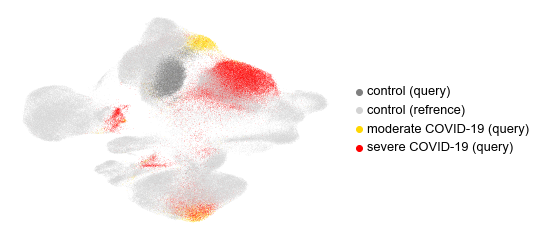

In [26]:
sc.pl.umap(adata, color=["condition2"], palette=["grey","lightgrey","gold","red"], save="_condition_covid_2.pdf", title="")

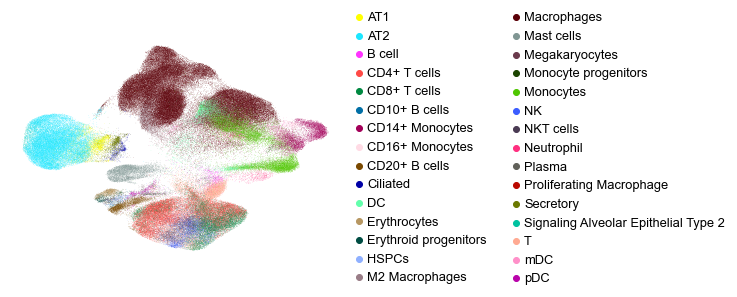

In [27]:
sc.pl.umap(adata, color=["celltype"], palette=sc.pl.palettes.godsnot_102,title="", save="_cell_type_covid.pdf")

In [28]:
adata.obs["study2"].replace(['Oetjen_A', 'Oetjen_P', 'Oetjen_U','Sun_sample1_CS', 'Sun_sample2_KC', 'Sun_sample3_TB', 'Sun_sample4_TC'],
                           ['Oetjen', 'Oetjen', 'Oetjen','Sun', 'Sun', 'Sun', 'Sun'],inplace=True)

In [29]:
lung = adata[adata.obs["study2"].isin(["Northwestern_Misharin_2018Reyfman","Sanger_Meyer_2019Madissoon","Stanford_Krasnow_bioRxivTravaglini"])]
covid = adata[adata.obs["study2"].isin(["COVID-19"])]
other = adata[~adata.obs["study2"].isin(["COVID-19","Northwestern_Misharin_2018Reyfman","Sanger_Meyer_2019Madissoon","Stanford_Krasnow_bioRxivTravaglini"])]

In [30]:
covid.obs["celltype"].value_counts()

Macrophages     48734
T                3717
CD8+ T cells     2771
Neutrophil       1607
Secretory        1267
NK               1113
Plasma           1041
mDC               941
Ciliated          881
B cell            198
pDC               148
Mast cells         51
Name: celltype, dtype: int64

In [31]:
covid.obs["tissue"] = ["BALF"] * len(covid)
lung.obs["tissue"] = ["Lung"] * len(lung)

Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.


In [32]:
covid.obs_names_make_unique()
lung.obs_names_make_unique()
other.obs_names_make_unique()
adata = other.concatenate(covid,lung)

... storing 'age_range' as categorical
... storing 'anatomical_region' as categorical
... storing 'dataset' as categorical
... storing 'donor' as categorical
... storing 'ethnicity' as categorical
... storing 'last_author/PI' as categorical
... storing 'lung_vs_nasal' as categorical
... storing 'original_celltype_ann' as categorical
... storing 'pack_years' as categorical
... storing 'sample' as categorical
... storing 'sex' as categorical
... storing 'smoking' as categorical
... storing 'ann_level_1' as categorical
... storing 'ann_level_2' as categorical
... storing 'ann_level_3' as categorical
... storing 'ann_level_4' as categorical
... storing 'ann_level_5' as categorical
... storing 'ann_new' as categorical
... storing 'subject_type' as categorical
... storing 'study' as categorical
... storing 'study2' as categorical
... storing 'celltype' as categorical
... storing 'condition' as categorical
... storing 'cellnames' as categorical
... storing 'stage' as categorical
... storing '

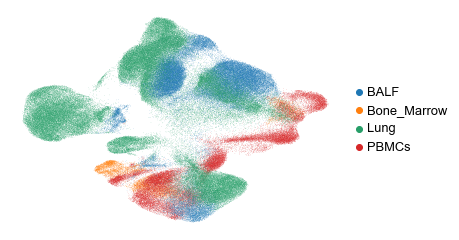

In [33]:
sc.pl.umap(adata, color=["tissue"], save="_tissue_covid.pdf", title="")

In [34]:
adata.obs["study"].replace("COVID-19", "COVID-19 (query)", inplace=True)

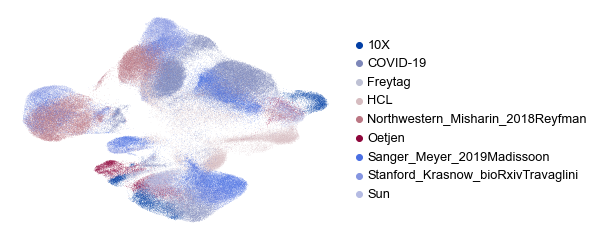

In [35]:
sc.pl.umap(adata, color=["study2"],palette=sc.pl.palettes.zeileis_28, save="_study_covid.pdf", title="")

In [36]:
# paga analysis 

In [37]:
adata_new = adata[(adata.obs["celltype"].isin(["Macrophages","Monocytes"]))&(adata.obs["tissue"].isin(["Lung","BALF"]))]

In [41]:
adata_mono = adata_new[adata_new.obs["celltype"] == "Monocytes"]
adata_mac = adata_new[adata_new.obs["celltype"] == "Macrophages"]

In [46]:
adata_mac.obs["condition"].cat.categories

Index(['control', 'moderate COVID-19', 'severe COVID-19'], dtype='object')

In [47]:
adata_mac.obs["condition2"]  = adata_mac.obs["condition"]

Trying to set attribute `.obs` of view, copying.


In [50]:
adata_mac.obs["condition2"].replace(['control', 'moderate COVID-19', 'severe COVID-19'],
                                    ['ctrl_Mac', 'moderate_COVID-19_Mac', 'severe_COVID-19_Mac'],inplace=True)

In [53]:
adata_mono.obs["condition2"] =  adata_mono.obs["celltype"]


Trying to set attribute `.obs` of view, copying.


In [54]:
adata_mono.obs_names_make_unique()
adata_mac.obs_names_make_unique()

In [55]:
adata2 = adata_mono.concatenate(adata_mac)

In [56]:
sc.pp.neighbors(adata2, use_rep="latent")

/home/mohammad/anaconda3/envs/tf/lib/python3.6/site-packages/numba/typed_passes.py:293: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../anaconda3/envs/tf/lib/python3.6/site-packages/umap/rp_tree.py", line 135:
@numba.njit(fastmath=True, nogil=True, parallel=True)
def euclidean_random_projection_split(data, indices, rng_state):
^

  state.func_ir.loc))
/home/mohammad/anaconda3/envs/tf/lib/python3.6/site-packages/umap/nndescent.py:92: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../anaconda3/envs/tf/lib/pyt

In [57]:
sc.tl.paga(adata2,groups="condition2")

... storing 'donor' as categorical
... storing 'original_celltype_ann' as categorical
... storing 'sample' as categorical
... storing 'ann_level_3' as categorical
... storing 'ann_level_4' as categorical
... storing 'ann_level_5' as categorical
... storing 'study' as categorical
... storing 'study2' as categorical
... storing 'celltype' as categorical
... storing 'condition' as categorical
... storing 'cellnames' as categorical
... storing 'ID' as categorical
... storing 'sample_new' as categorical
... storing 'tissue' as categorical
... storing 'condition2' as categorical


In [62]:
sc.tl.umap(adata2)

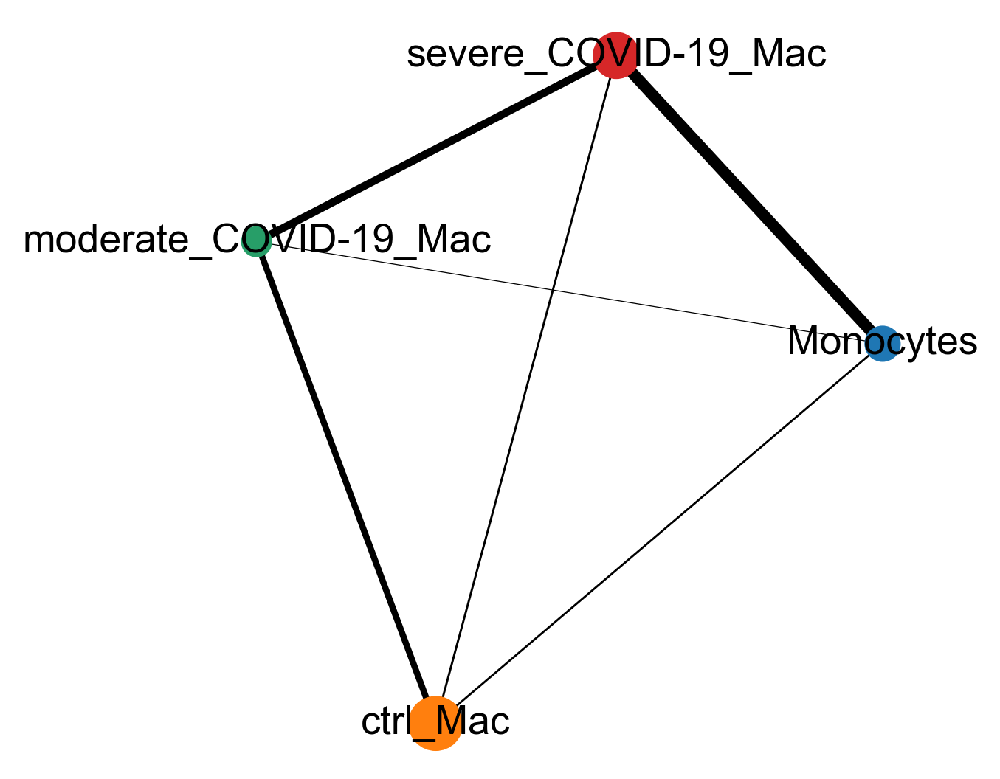

In [85]:
sc.pl.paga(adata2, color=["condition2"], title="",save="_no_filtered.pdf")

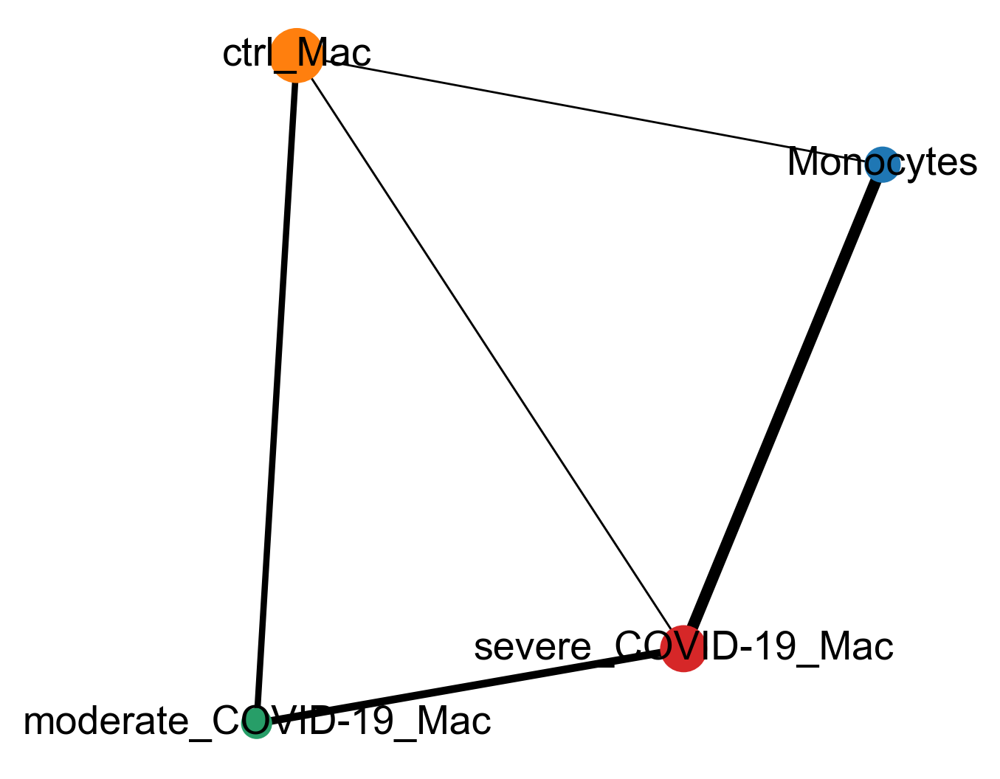

In [86]:
sc.pl.paga(adata2, color=["condition2"], title="",save="_no_thresh.pdf", threshold=0.05)

In [42]:
# Macrhophages

In [49]:
adata_new = adata[adata.obs["celltype"] == "Macrophages"]

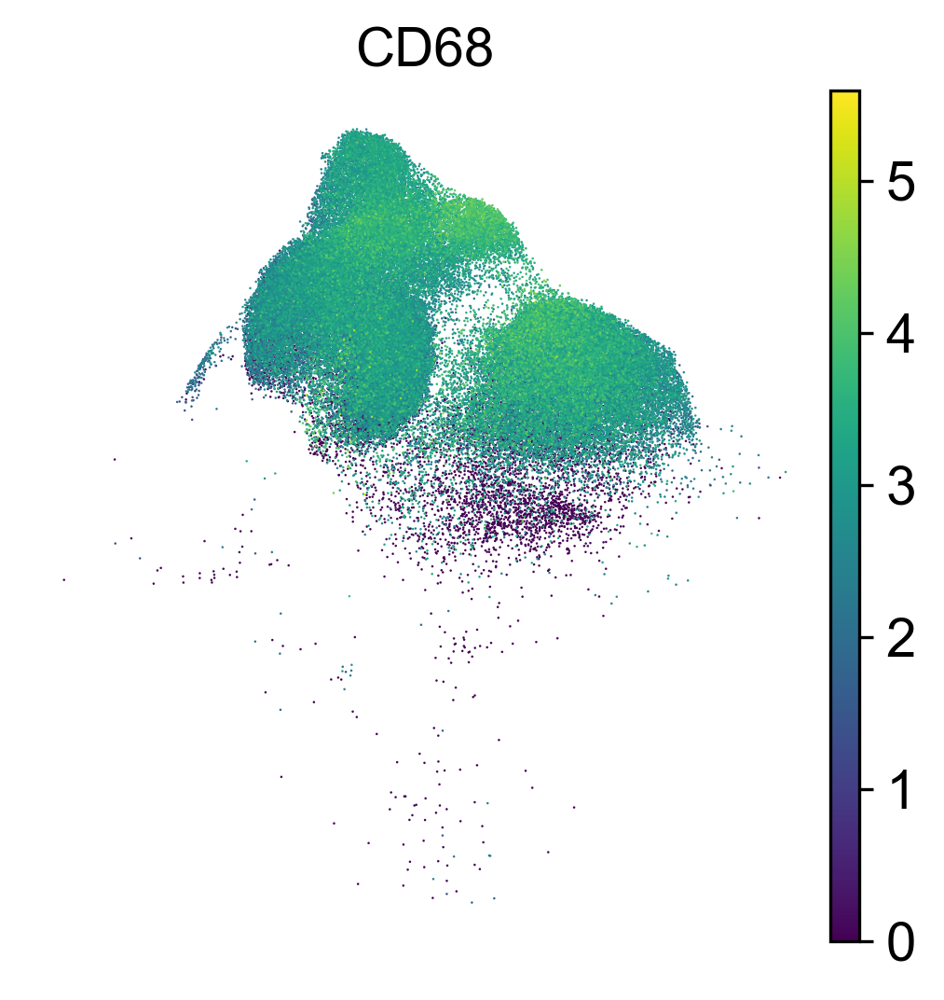

In [50]:
sc.pl.umap(adata_new, color = ["CD68"], use_raw=False, save="CD68.pdf")

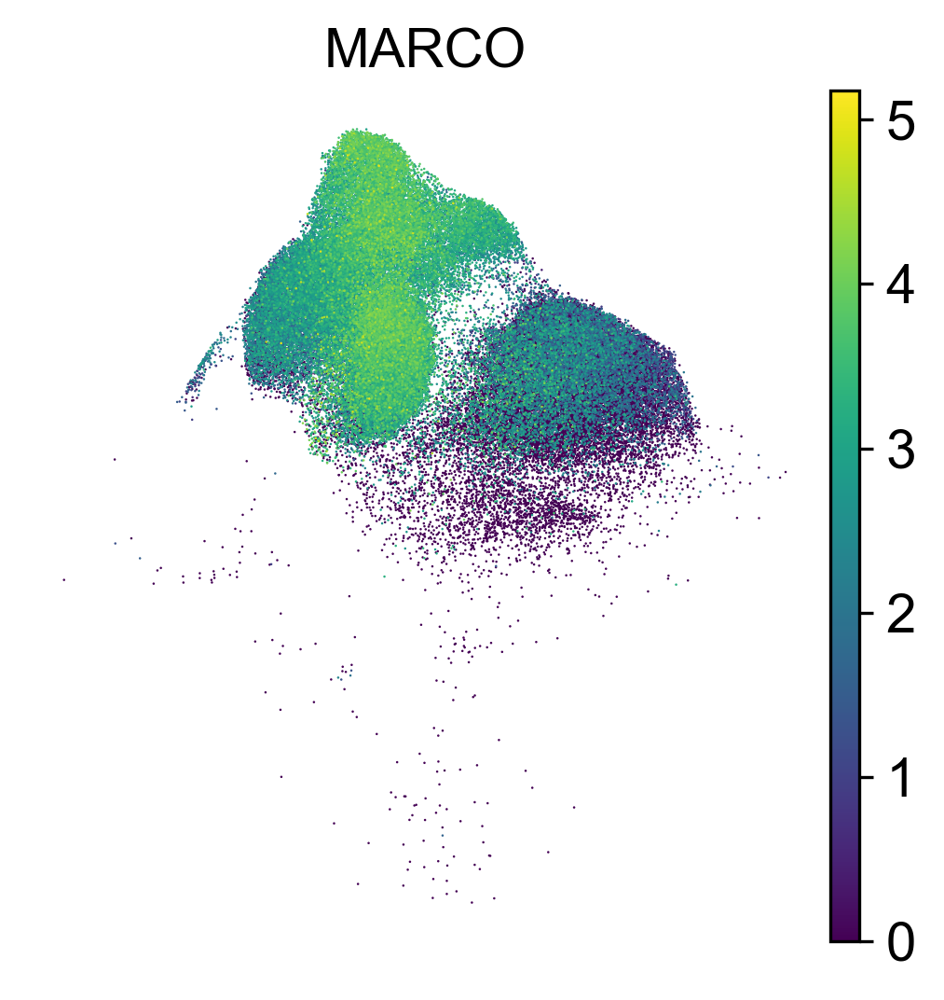

In [51]:
sc.pl.umap(adata_new, color = ["MARCO"], use_raw=False,save="MARCO.pdf")

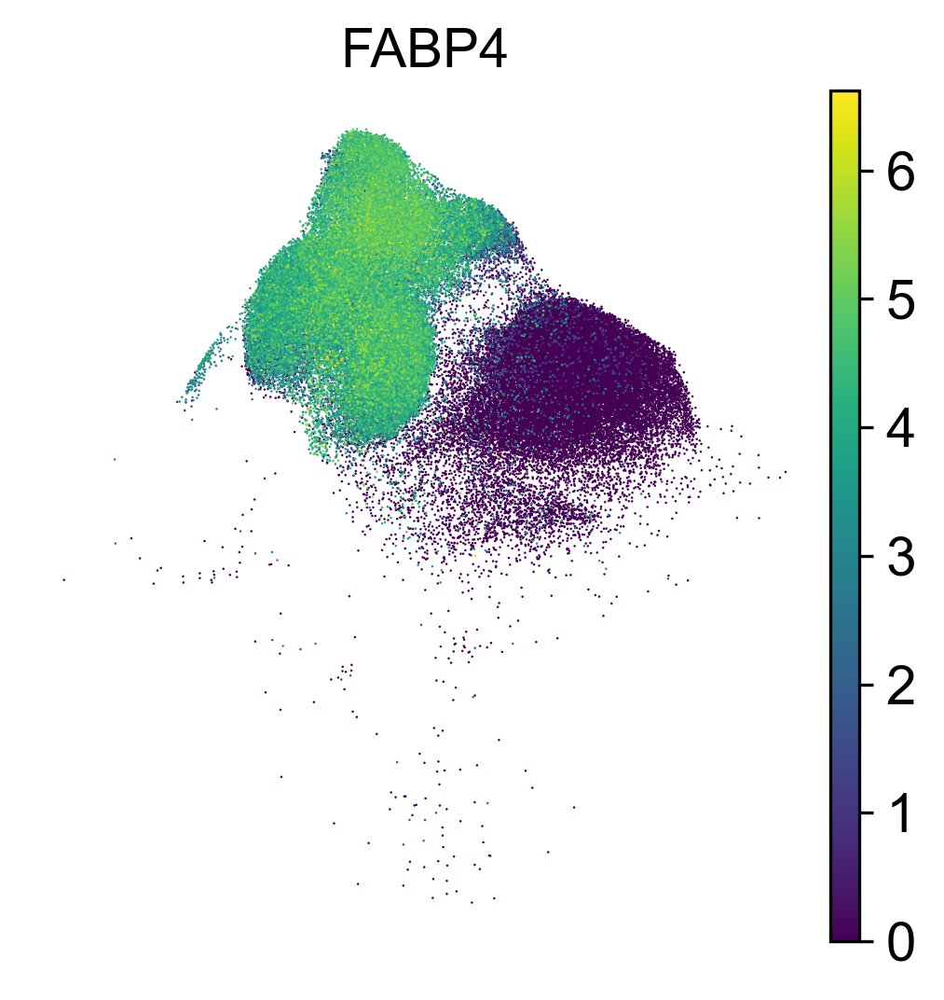

In [52]:
sc.pl.umap(adata_new, color = ["FABP4"],save="Fabp4.pdf")

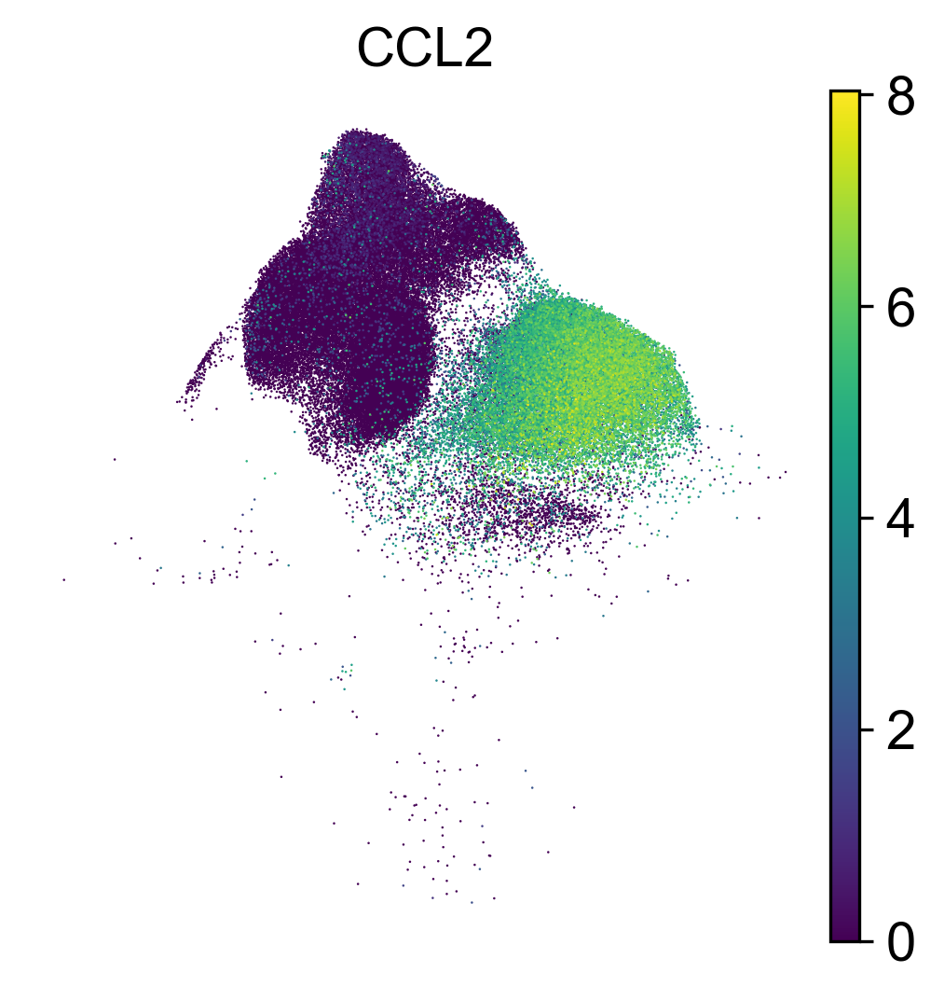

In [53]:
sc.pl.umap(adata_new, color = ["CCL2"], use_raw=False, save="CCL2.pdf")

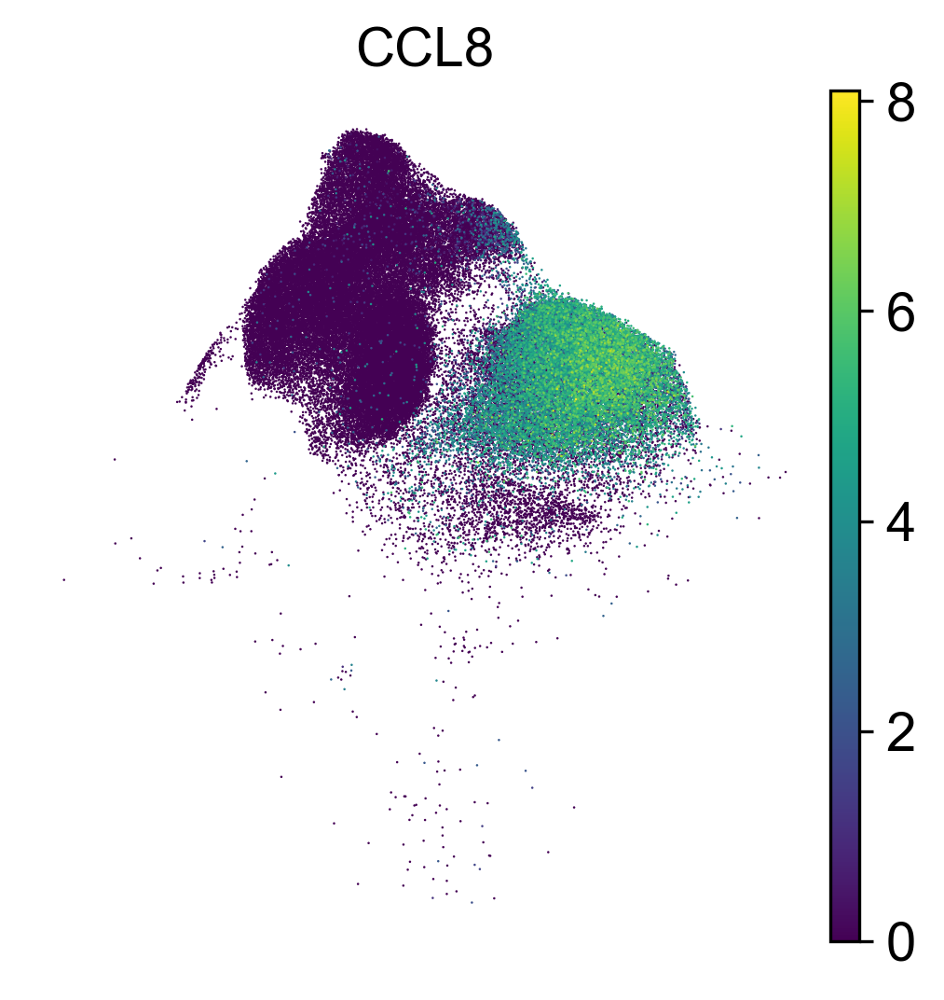

In [54]:
sc.pl.umap(adata_new, color = ["CCL8"], use_raw=False, save="CCL8.pdf")

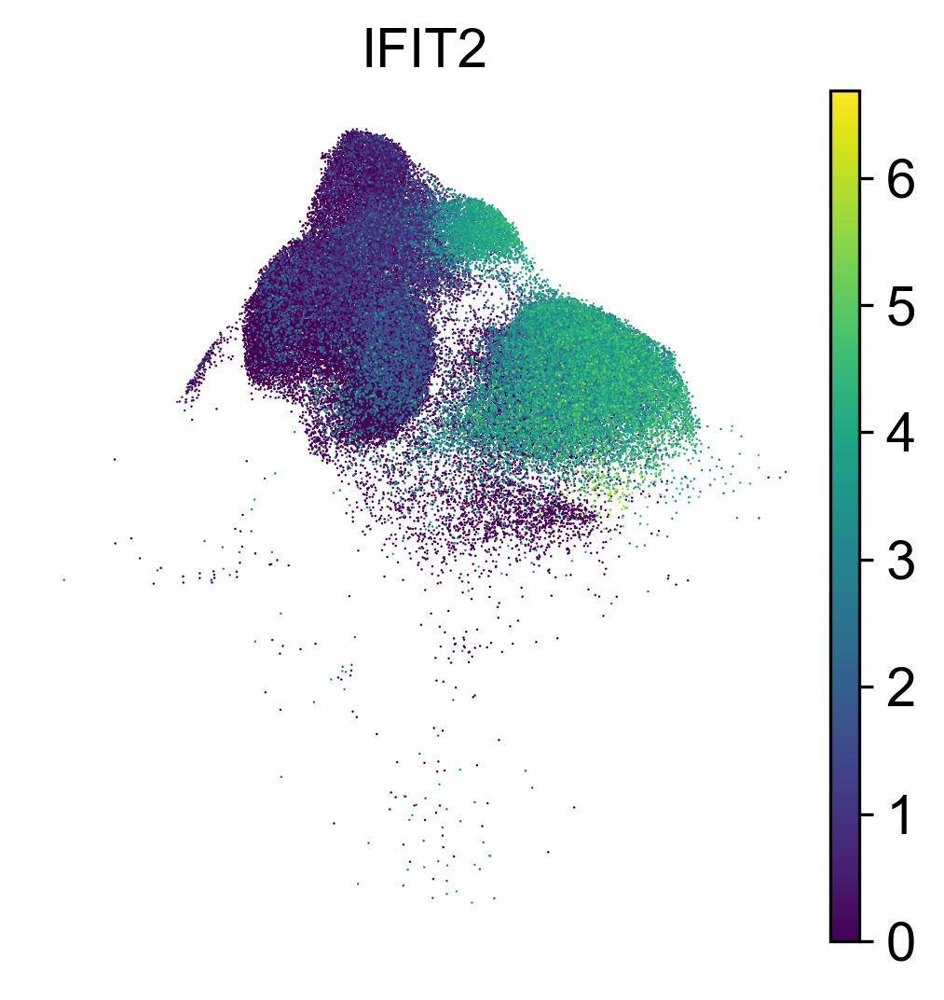

In [55]:
sc.pl.umap(adata_new, color = ["IFIT2"], use_raw=False, save="IFIT2.pdf")

In [56]:
#M2 machropahes

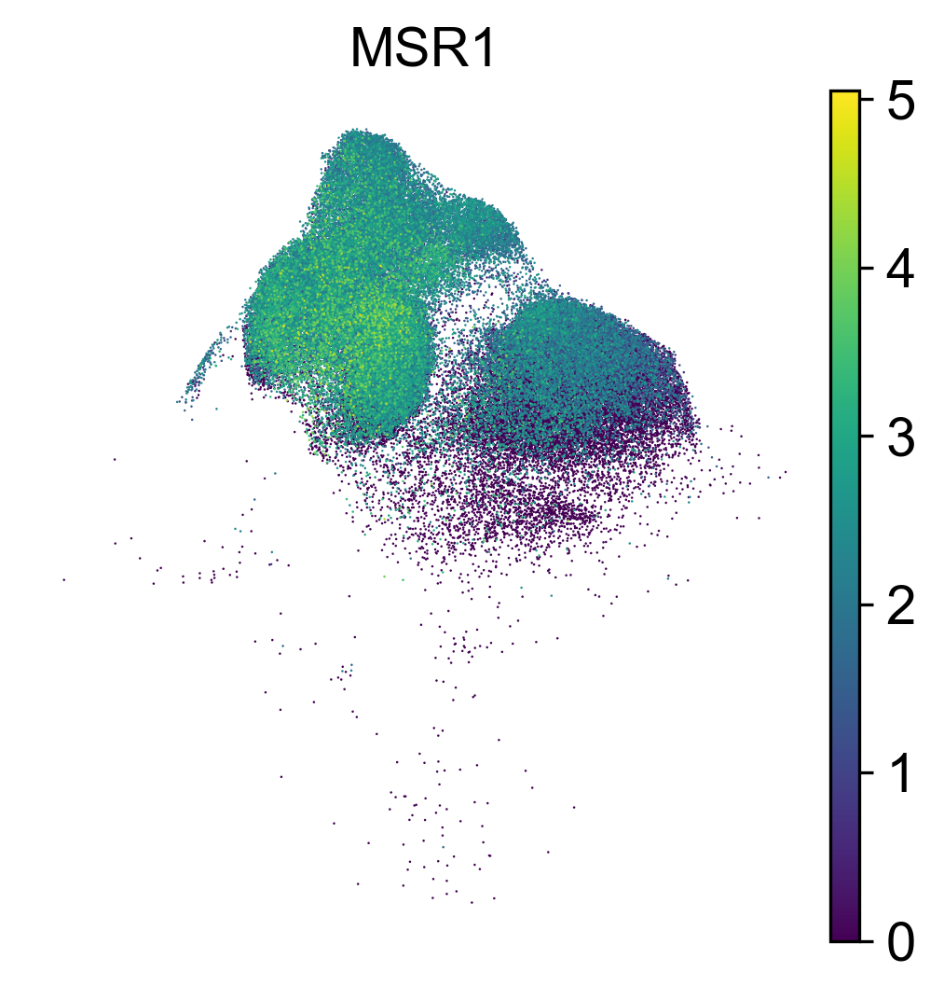

In [57]:
sc.pl.umap(adata_new, color = ["MSR1"], use_raw=False, save="MSR1.pdf")

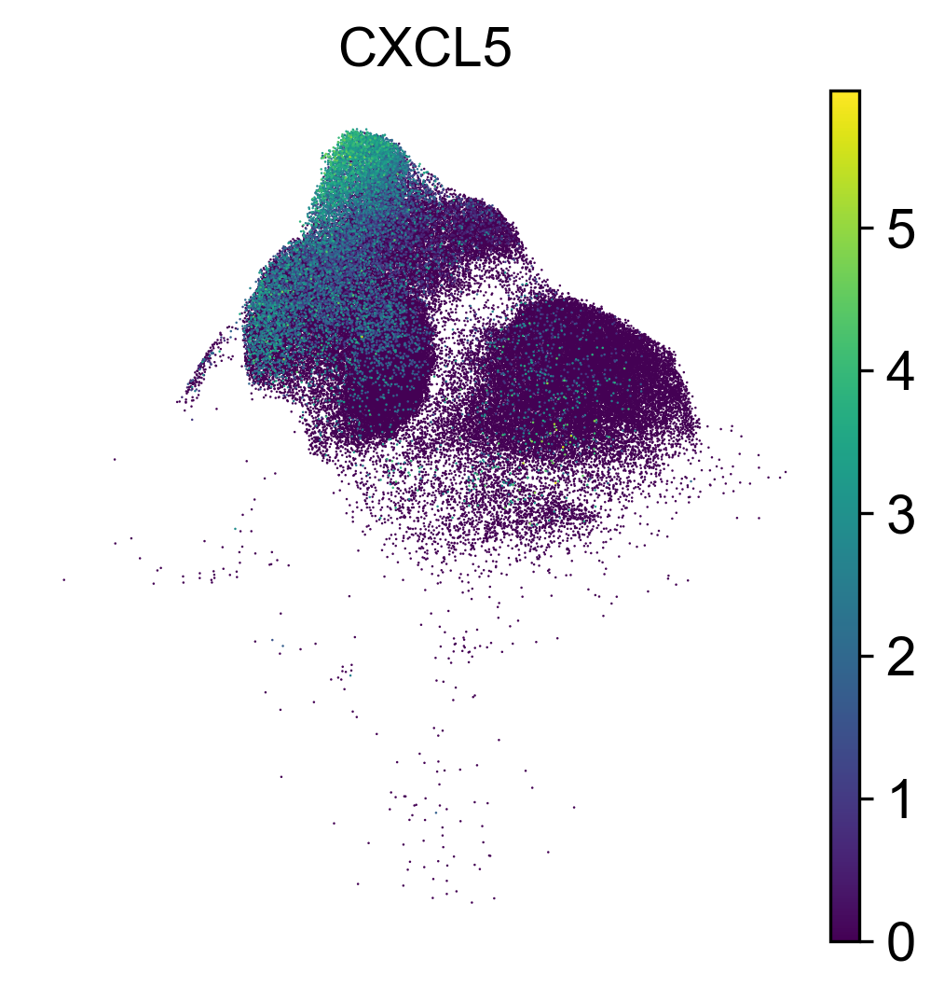

In [58]:
sc.pl.umap(adata_new, color = ["CXCL5"], use_raw=False, save="CXCL5.pdf")


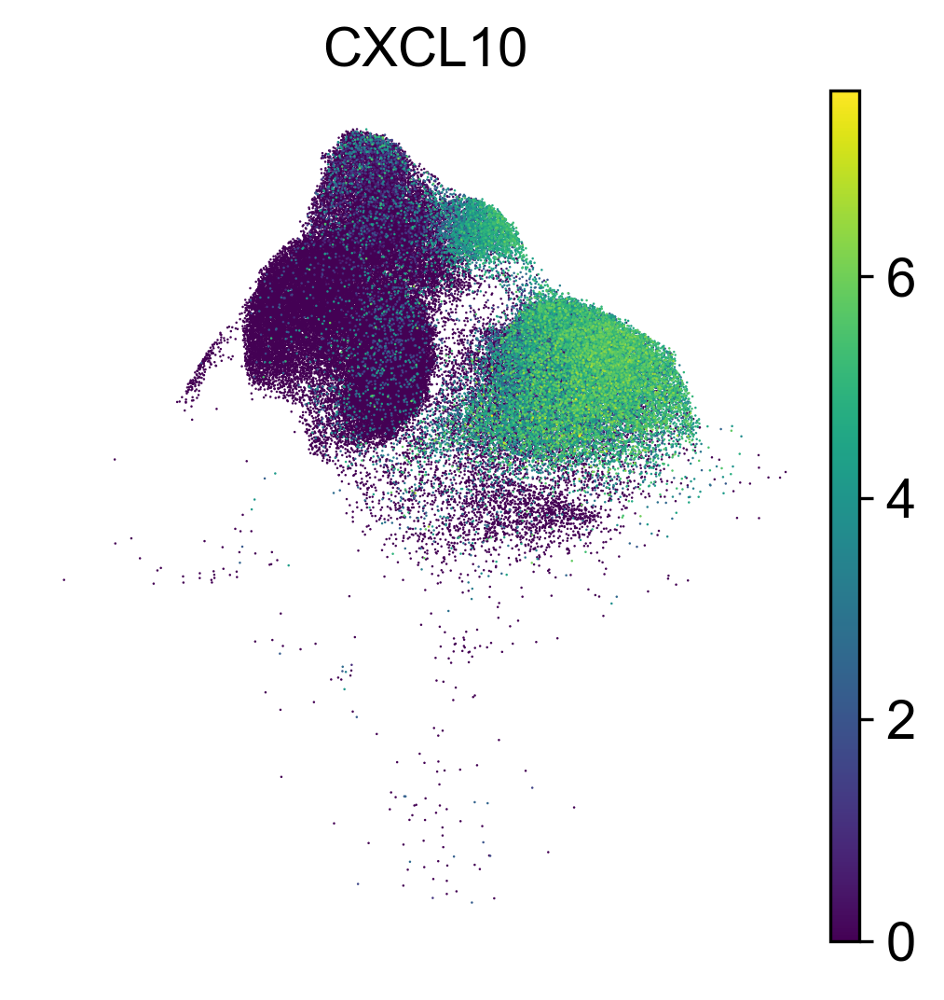

In [59]:
sc.pl.umap(adata_new, color = ["CXCL10"], use_raw=False, save="CXCL10.pdf")


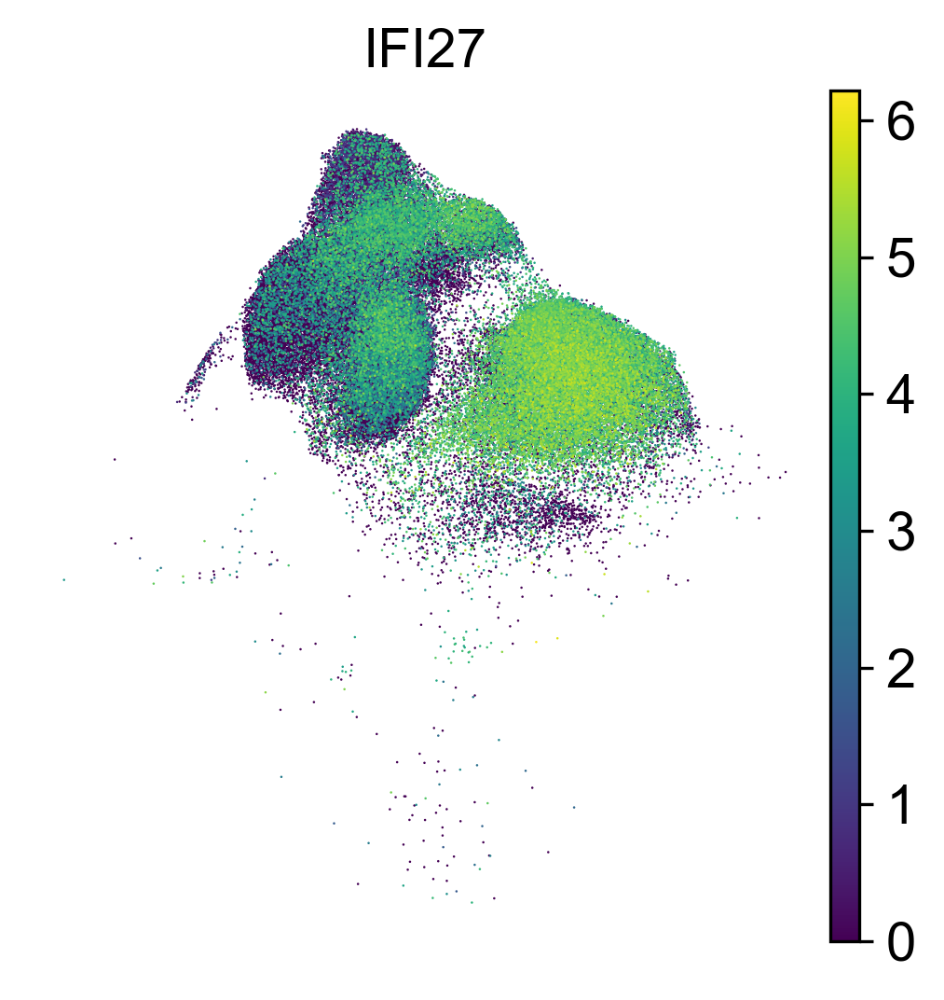

In [60]:
sc.pl.umap(adata_new, color = ["IFI27"], use_raw=False, save="IFI27.pdf")

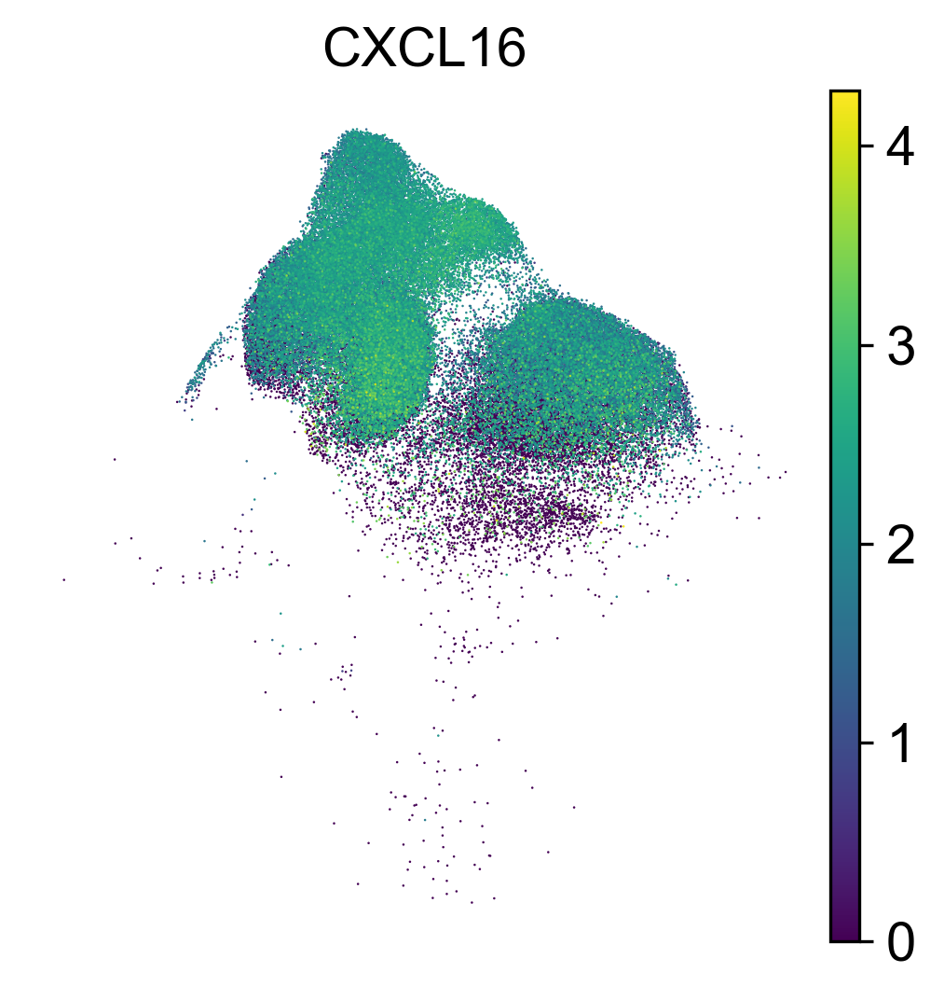

In [61]:
sc.pl.umap(adata_new, color = ["CXCL16"], use_raw=False,save="CCL2.pdf")

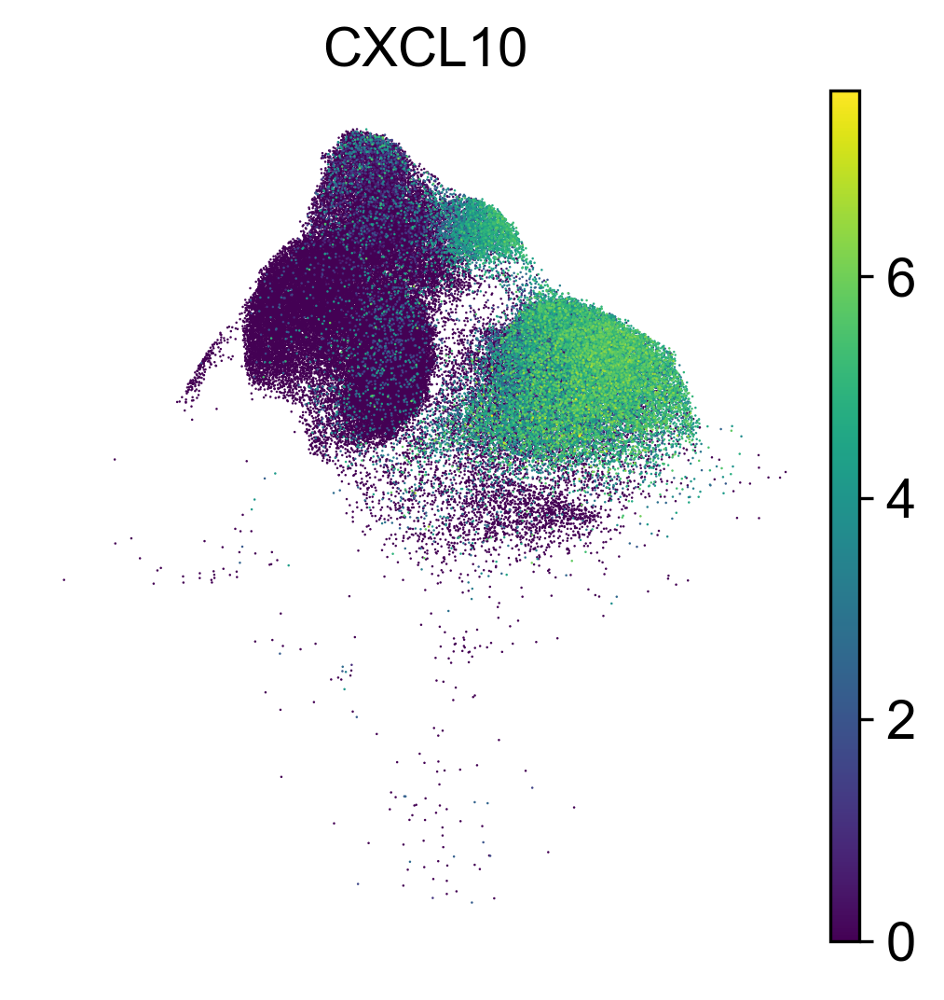

In [62]:
sc.pl.umap(adata_new, color = ["CXCL10"])

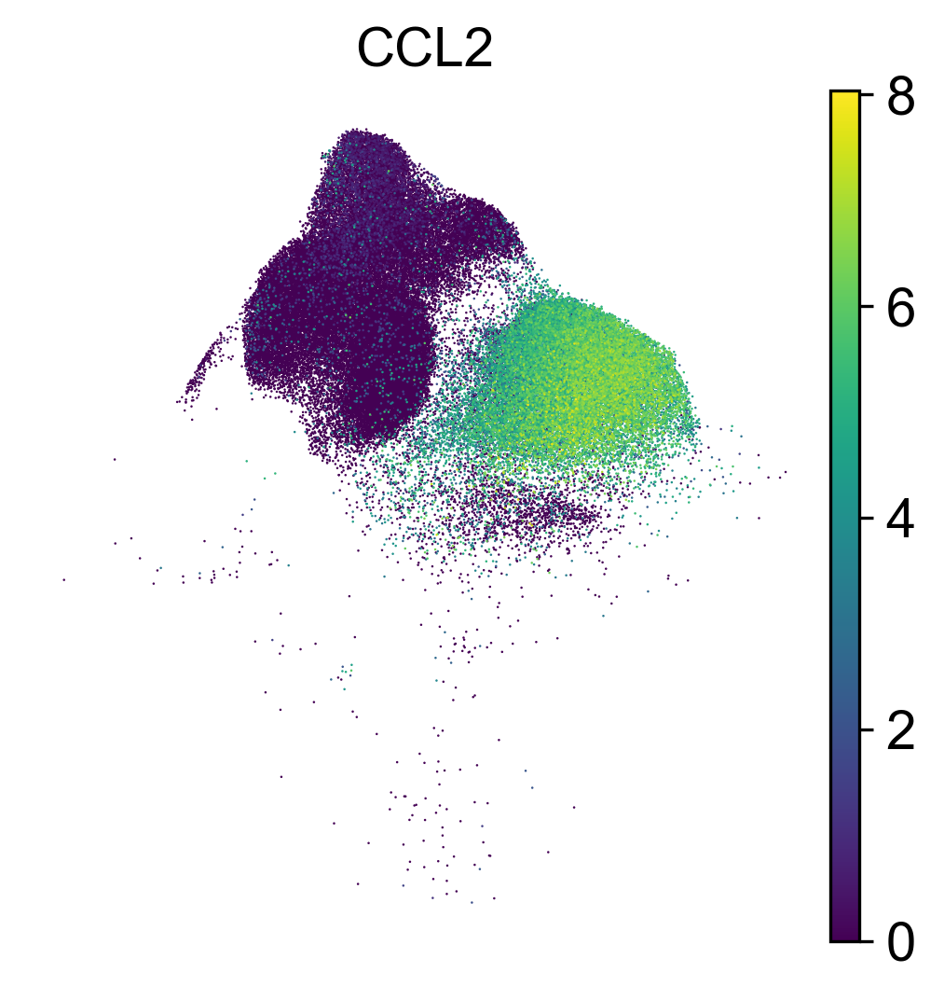

In [63]:
sc.pl.umap(adata_new, color = ["CCL2"], use_raw=False,save="CCL2.pdf")

IFIT+ 

In [64]:
adata_d12 = adata[adata.obs["donor"].isin(["donor_1","donor_2","donor_3"])]

In [65]:
adata_d12_m = adata_d12[adata_d12.obs["celltype"] == "Macrophages"]

In [66]:
adata_d12_m

View of AnnData object with n_obs × n_vars = 14734 × 18474
    obs: 'age', 'age_range', 'anatomical_region', 'anatomical_region_detailed', 'batch', 'dataset', 'disease', 'donor', 'ethnicity', 'ethnicity_mixed', 'last_author/PI', 'lung_vs_nasal', 'original_celltype_ann', 'pack_years', 'sample', 'sample_alias', 'sample_type', 'sampling_method', 'sex', 'smoking', 'total_counts', 'log10_total_counts', 'n_genes_detected', 'mito_frac', 'ribo_frac', 'compl', 'ann_level_1', 'ann_level_2', 'ann_level_3', 'ann_level_4', 'ann_level_5', 'ann_highest_res', 'ann_new', 'subject_type', 'study', 'study2', 'celltype', 'condition', 'cellnames', 'cluster', 'stage', 'ID', 'sample_new', 'chemistry', 'data_type', 'dpt_pseudotime', 'final_annotation', 'mt_frac', 'n_counts', 'n_genes', 'sample_ID', 'size_factors', 'species', 'tissue', 'scale_factors', 'condition2'
    var: 'n_cells-0', 'n_cells-0-0-1-0-0-0', 'feature_types-1-0-1-0-0-0', 'genome-1-0-1-0-0-0', 'n_cells-0-0-1-1-0-0', 'feature_types-1-0-1-1-0-0', 

Trying to set attribute `.uns` of view, copying.


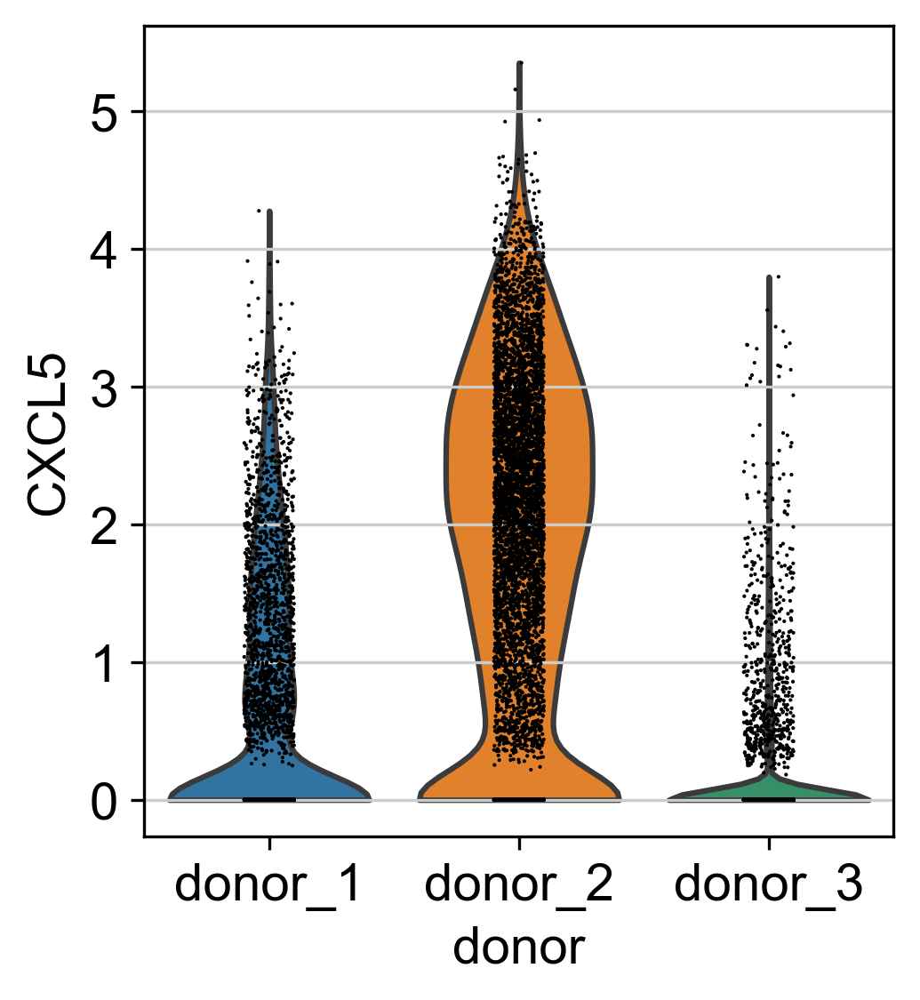

In [67]:
sc.pl.violin(adata_d12_m, keys= ["CXCL5"],groupby="donor", use_raw=False)

Trying to set attribute `.uns` of view, copying.


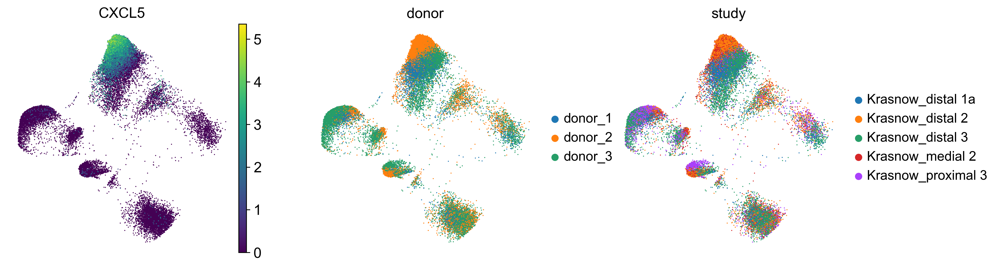

In [68]:
sc.pl.umap(adata_d12, color = ["CXCL5","donor","study"], use_raw=False)

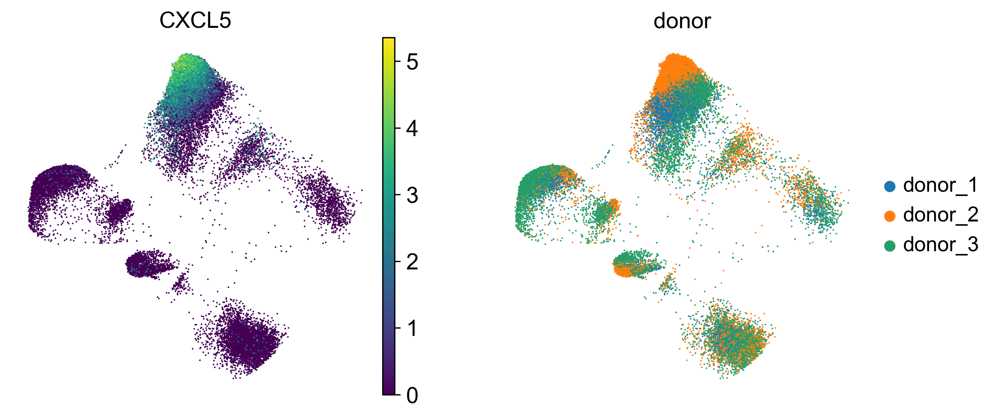

In [69]:
sc.pl.umap(adata_d12, color = ["CXCL5","donor"], use_raw=False)

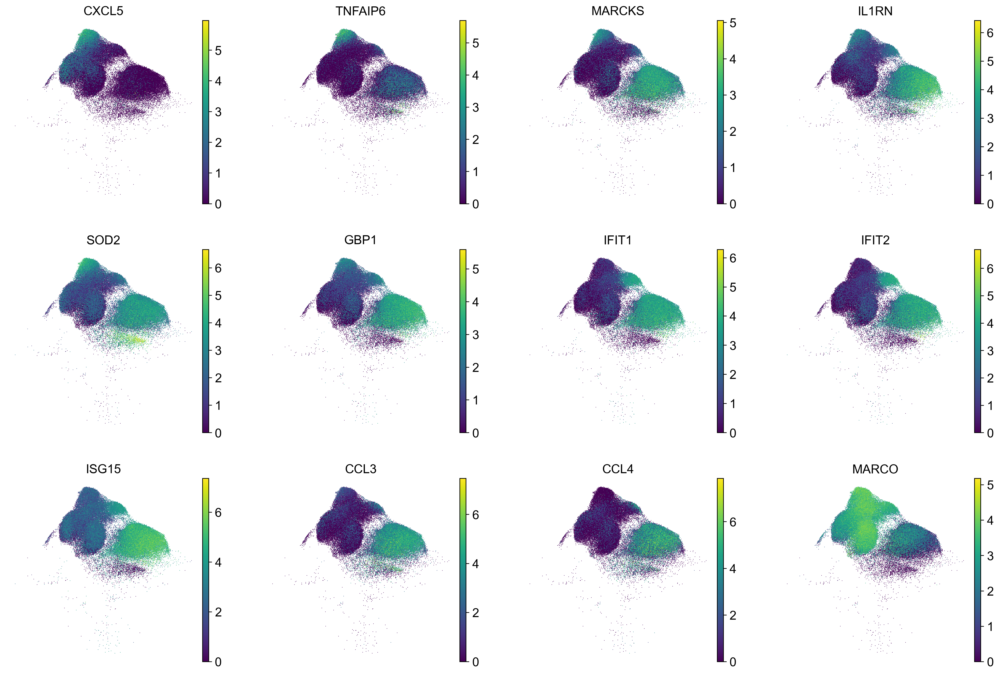

In [70]:
sc.pl.umap(adata_new, color = ["CXCL5","TNFAIP6","MARCKS","IL1RN","SOD2","GBP1","IFIT1","IFIT2","ISG15","CCL3","CCL4","MARCO"], use_raw=False)

IFIT+ activated cells

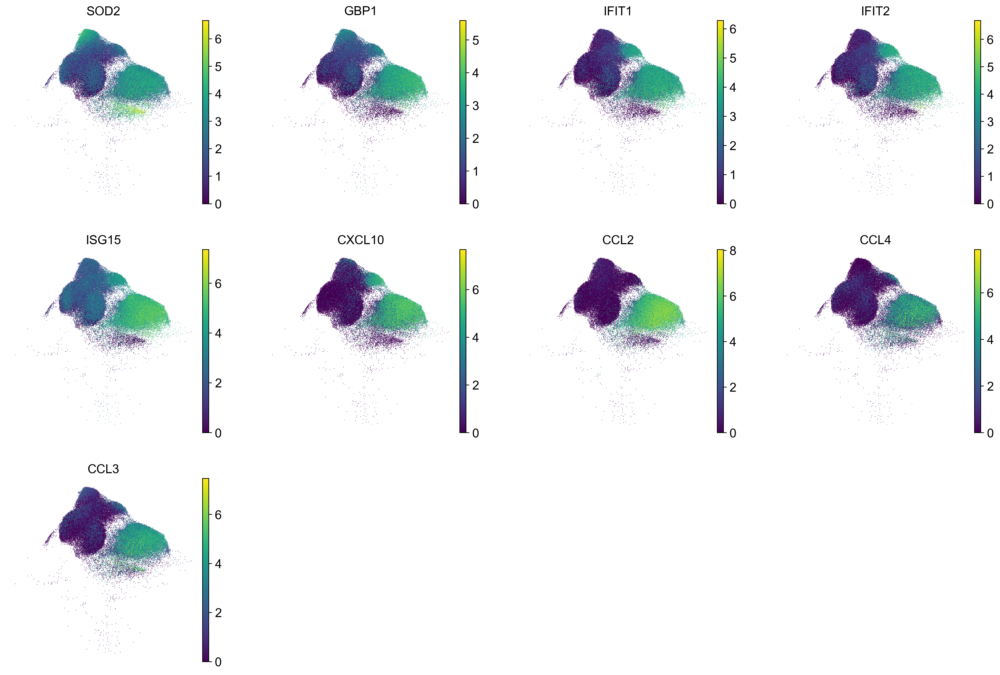

In [71]:
sc.pl.umap(adata_new, color = ["SOD2","GBP1","IFIT1","IFIT2","ISG15","CXCL10","CCL2","CCL4","CCL3"], use_raw=False)

C1Q+ Macrophages

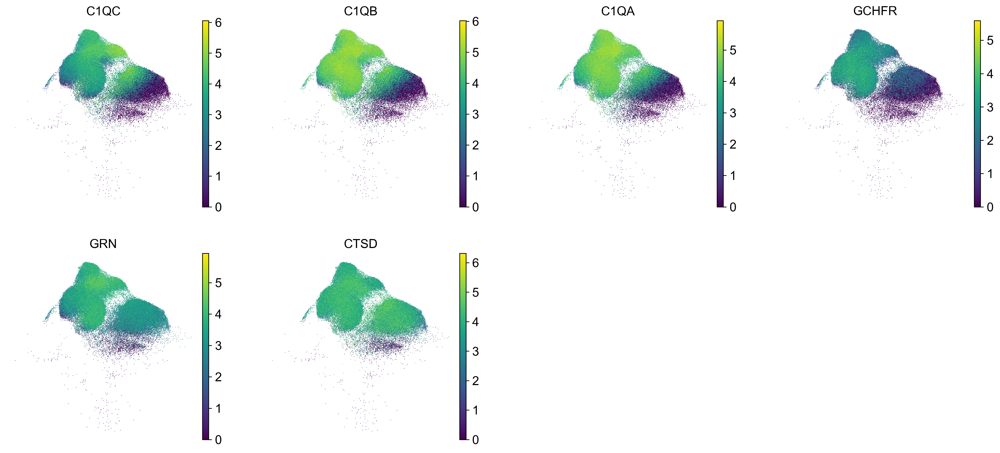

In [72]:
sc.pl.umap(adata_new, color = ["C1QC", "C1QB","C1QA","GCHFR","GRN","CTSD"], use_raw=False)

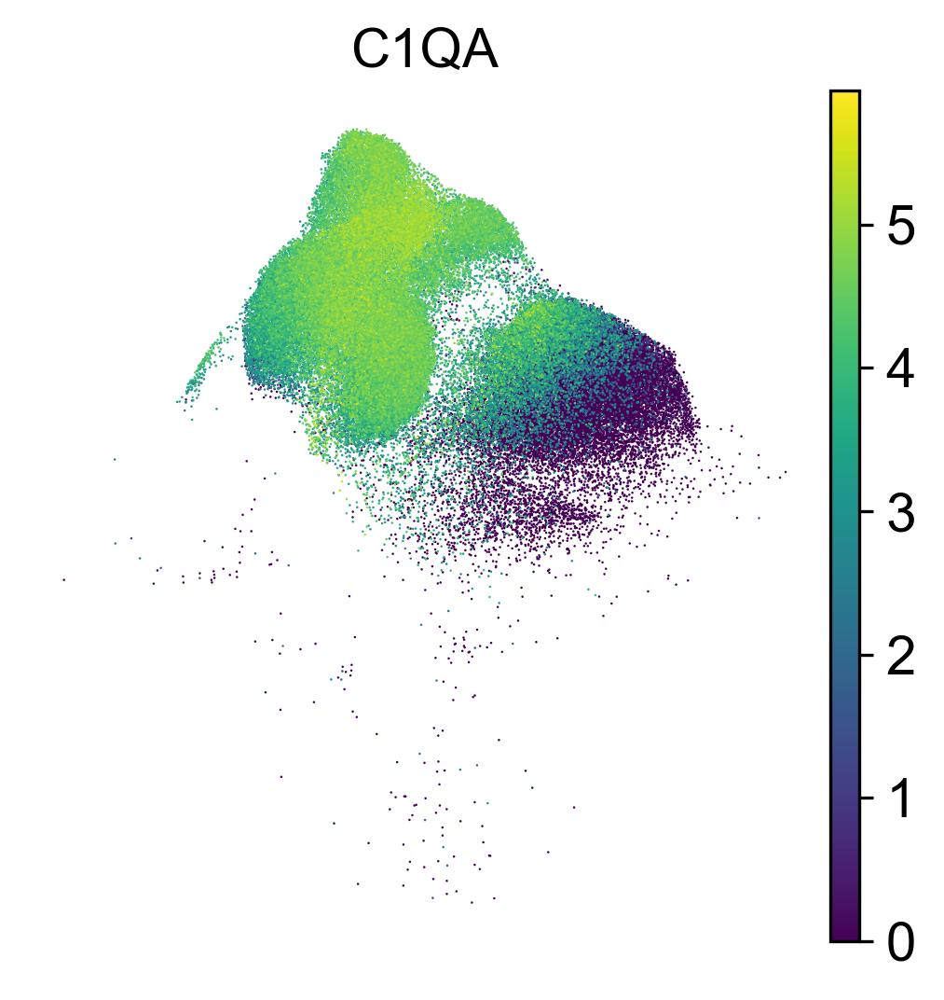

In [73]:
sc.pl.umap(adata_new, color = ["C1QA"], use_raw=False,save="C1Q+.pdf")

In [74]:
# iMMUNE CELLS

In [75]:
covid.obs["celltype"].value_counts()

Macrophages     48734
T                3717
CD8+ T cells     2771
Neutrophil       1607
Secretory        1267
NK               1113
Plasma           1041
mDC               941
Ciliated          881
B cell            198
pDC               148
Mast cells         51
Name: celltype, dtype: int64

In [76]:
adata.obs["study"].value_counts()

COVID-19 (query)                     62469
Northwestern_Misharin_2018Reyfman    35447
Sanger_Meyer_2019Madissoon           34407
HCL                                  23061
10X                                  10727
Krasnow_distal 3                     10291
Krasnow_distal 2                      6129
Krasnow_distal 1a                     4675
Krasnow_proximal 3                    4248
Krasnow_medial 2                      3981
Oetjen_U                              3730
Freytag                               3347
Oetjen_P                              3265
Oetjen_A                              2586
Sun_sample4_TC                        2420
Sun_sample3_TB                        2403
Sun_sample2_KC                        2281
Sun_sample1_CS                        1725
Name: study, dtype: int64

In [77]:
adata_new = adata

In [78]:
immune = adata_new[adata_new.obs["celltype"].isin(["CD8+ T cells"])]

In [79]:
immune.obs["celltype"].value_counts()

CD8+ T cells    12891
Name: celltype, dtype: int64

In [80]:
sc.pp.neighbors(immune, use_rep="latent")

/home/mohammad/anaconda3/envs/tf/lib/python3.6/site-packages/numba/typed_passes.py:293: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../anaconda3/envs/tf/lib/python3.6/site-packages/umap/rp_tree.py", line 135:
@numba.njit(fastmath=True, nogil=True, parallel=True)
def euclidean_random_projection_split(data, indices, rng_state):
^

  state.func_ir.loc))
/home/mohammad/anaconda3/envs/tf/lib/python3.6/site-packages/umap/nndescent.py:92: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../anaconda3/envs/tf/lib/pyt

In [81]:
sc.tl.umap(immune)

/home/mohammad/packages/scanpy/scanpy/tools/_umap.py:144: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adata.uns['neighbors']['connectivities'].tocoo(),


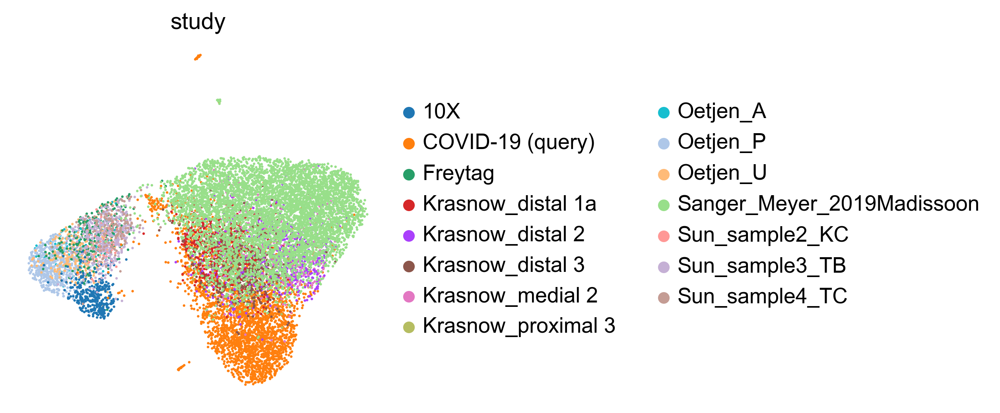

In [82]:
sc.pl.umap(immune, color=["study"],use_raw=False,save="cd8t_study.pdf")

In [83]:
immune.obs["condition"].value_counts()

control              10420
moderate COVID-19     1296
severe COVID-19       1175
Name: condition, dtype: int64

In [84]:
immune.obs["sample"] = immune.obs["tissue"] 

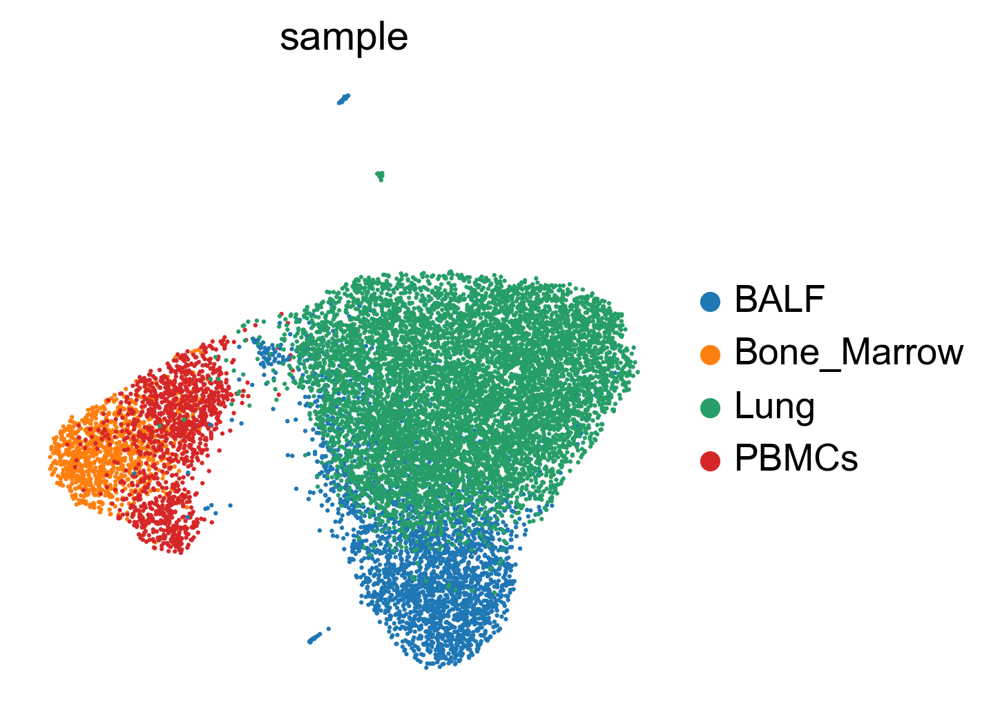

In [85]:
sc.pl.umap(immune, color=["sample"],use_raw=False, save="sample_tcell.pdf")

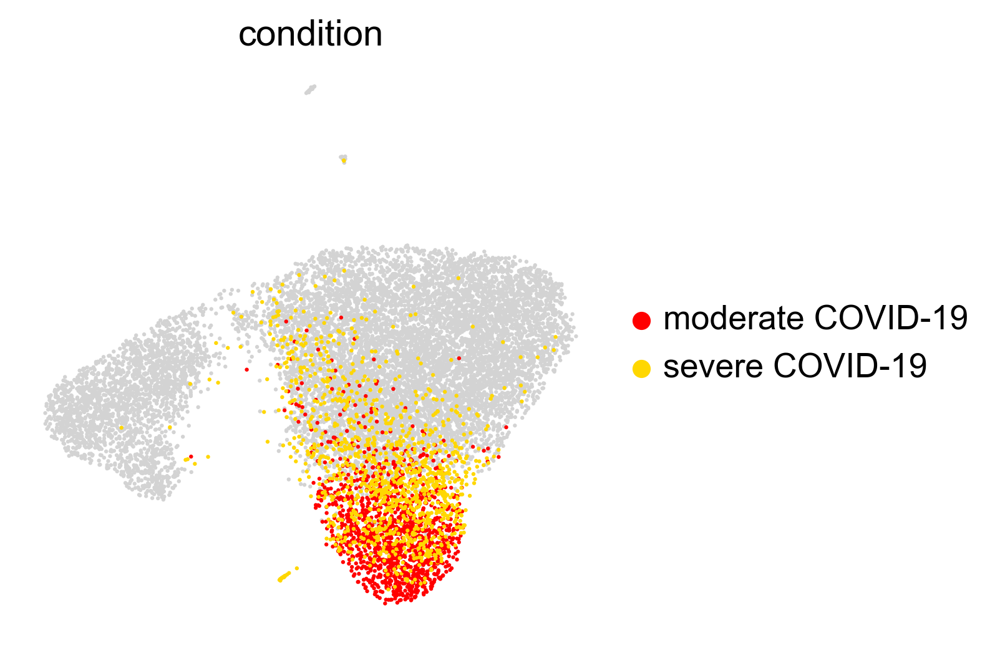

In [86]:
sc.pl.umap(immune, color=["condition"],palette=["lightgrey","red","gold"],
           use_raw=False,groups=["moderate COVID-19","severe COVID-19"],save="t_cell_condition.pdf")

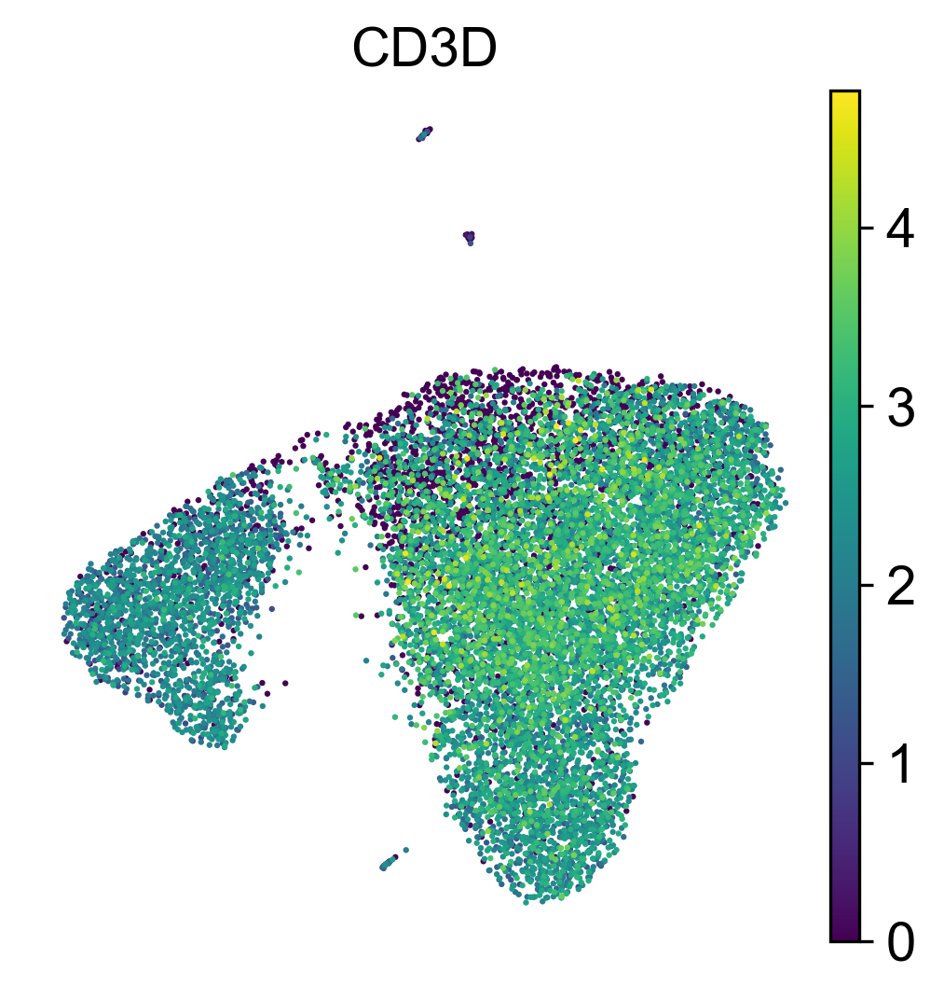

In [88]:
sc.pl.umap(immune, color=["CD3D"],save="genes_t_CD3D.pdf",use_raw=False,)

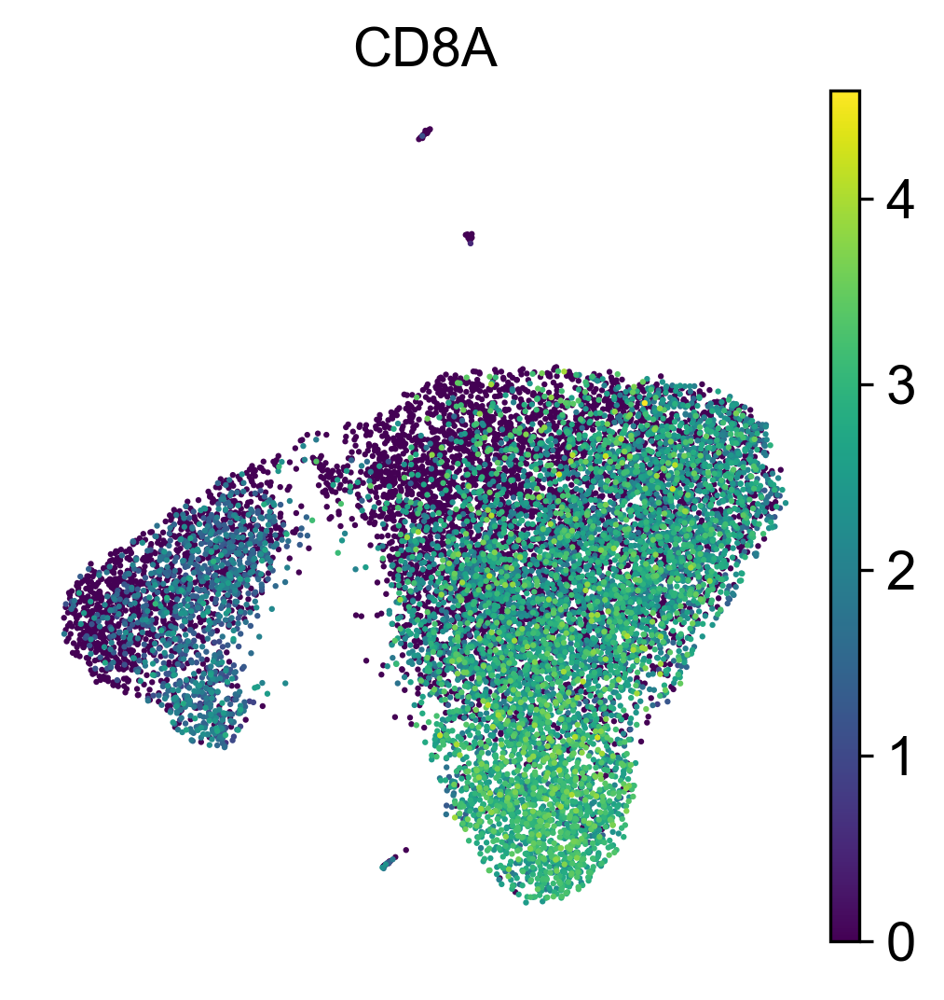

In [89]:
sc.pl.umap(immune, color=["CD8A"],save="genes_t_CD8A.pdf",use_raw=False,)

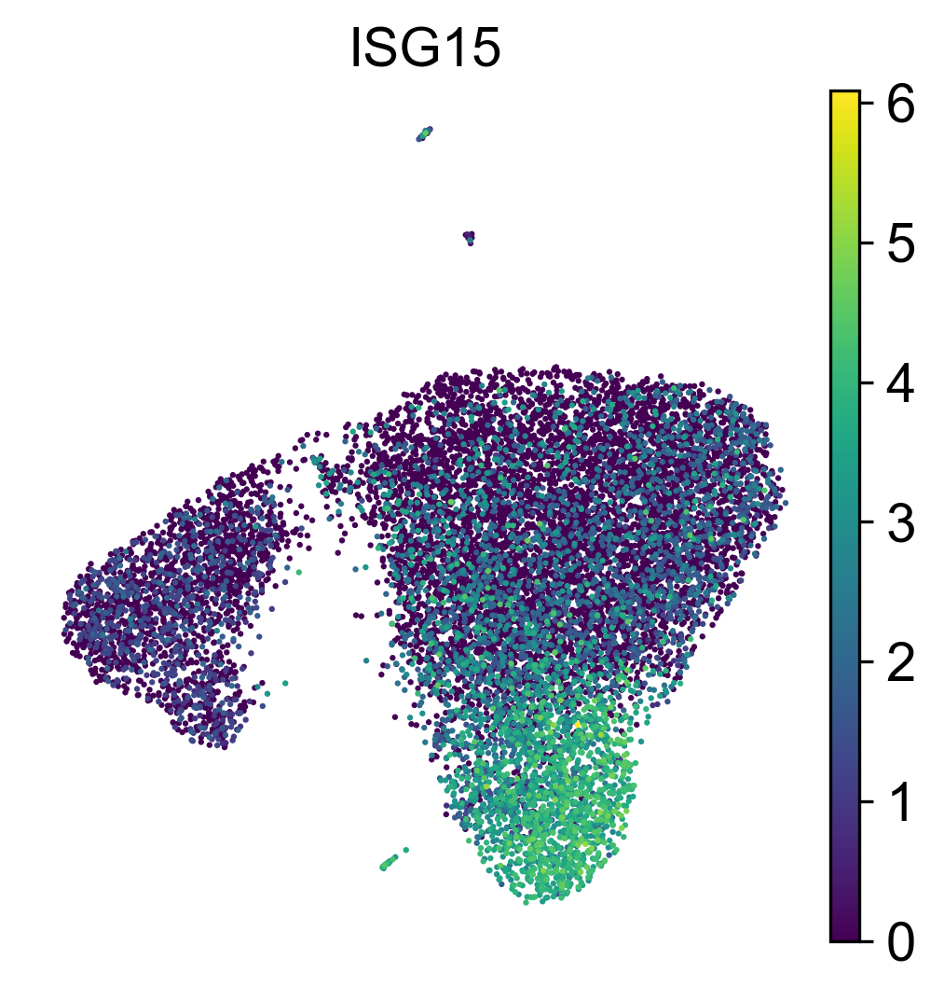

In [90]:
sc.pl.umap(immune, color=["ISG15"],save="genes_t_ISG15.pdf",use_raw=False,)

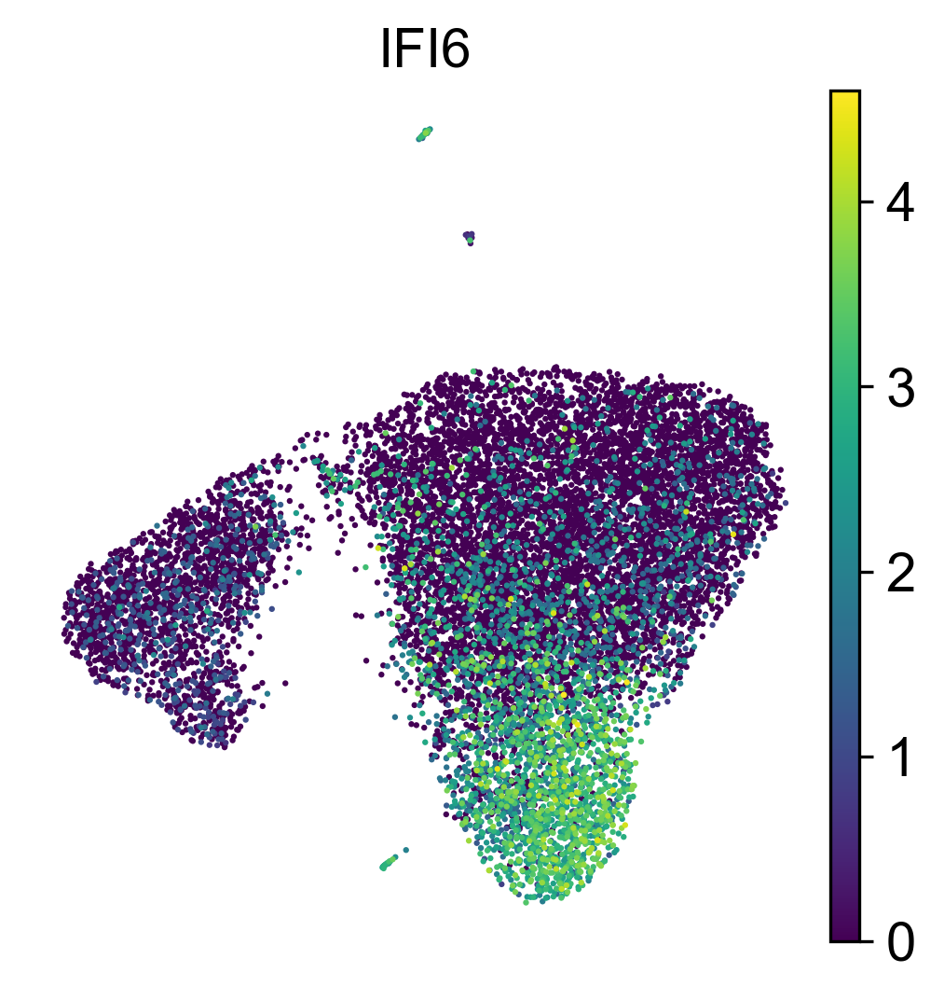

In [91]:
sc.pl.umap(immune, color=["IFI6"],save="genes_t_IFI6.pdf",use_raw=False,)

In [94]:
immune_t_l = immune[immune.obs["sample"].isin(["BALF","Lung"])]

In [95]:
sc.tl.rank_genes_groups(immune_t_l,groupby="sample")

Trying to set attribute `.uns` of view, copying.


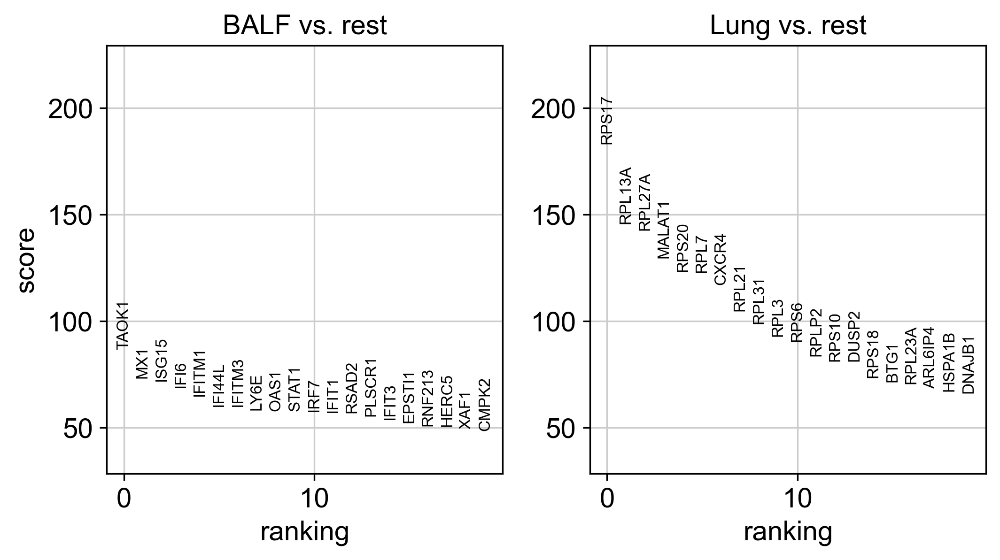

In [96]:
sc.pl.rank_genes_groups(immune_t_l)